<a href="https://colab.research.google.com/github/ssuzzang/project4/blob/main/section4_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

라이브러리 불러오기

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import keras.layers as layers
import keras.optimizers as optimizers
from keras.models import Model, load_model
from tensorflow.keras.utils import to_categorical
from keras.callbacks import LambdaCallback, ModelCheckpoint, ReduceLROnPlateau
import seaborn as sns
from PIL import Image
from skimage.transform import resize

import threading, random, os

구글드라이브 연동을 하여 데이터셋 불러오기

In [ ]:
from google.colab import drive
drive.mount('/content.drive')

Mounted at /content.drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow.keras.layers as layers
import tensorflow.keras.optimizers as optimizers
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import LambdaCallback, ModelCheckpoint, ReduceLROnPlateau
import seaborn as sns
from PIL import Image
from skimage.transform import resize
import threading, random, os

#원본 이미지: 0~255의 픽셀값으로 이루어진 원본 이미지.
imgs = np.load('/content.drive/MyDrive/코드스테이츠/p4/윌리/imgs_uint8.npy').astype(np.float32)/255.
# lables: 위의 이미지 +월리가 없는 곳은 0, 있는 곳은 255로 채워짐
labels = np.load('/content.drive/MyDrive/코드스테이츠/p4/윌리/labels_uint8.npy').astype(np.float32)/255.
# waldo_sub_imgs: 월리가 있는 부분의 장소를 크롭한 장소의 이미지
waldo_sub_imgs = np.load('/content.drive/MyDrive/코드스테이츠/p4/윌리/waldo_sub_imgs_uint8.npy',allow_pickle=True)/255.
# waldo_sub_labels: 위의 이미지 + 크롭된 부분을 255, 밖은 0으로 채워짐
waldo_sub_labels = np.load('/content.drive/MyDrive/코드스테이츠/p4/윌리/waldo_sub_labels_uint8.npy',allow_pickle=True)/255.

print(imgs.shape, labels.shape)
print(waldo_sub_imgs.shape, waldo_sub_labels.shape)

(18, 1760, 2800, 3) (18, 1760, 2800)
(18,) (18,)


In [ ]:
for x in [imgs, labels, waldo_sub_imgs, waldo_sub_labels]:
  print(len(x))

18
18
18
18


위의 데이터를 확인해본 결과 18장의 이미지가 있는것으로 확인됩니다.

>>> Image Visualization


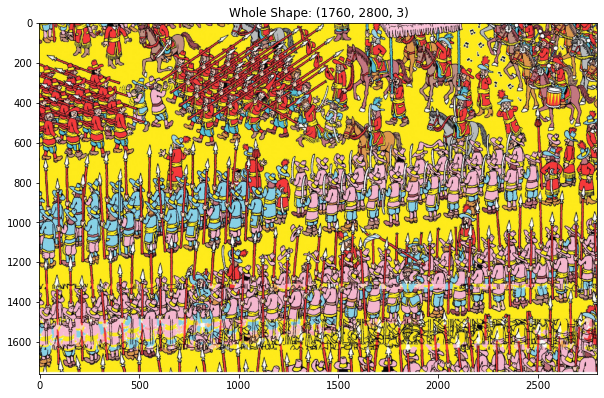

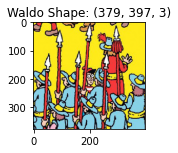

In [ ]:
print('>>> Image Visualization')

plt.figure(figsize=(10, 10))
plt.title("Whole Shape: {}".format(imgs[0].shape))
plt.imshow(imgs[0])

plt.figure(figsize=(2, 2))
plt.title("Waldo Shape: {}".format(waldo_sub_imgs[0].shape))
plt.imshow(waldo_sub_imgs[0])
plt.show()

배치 이터레이터 (iterator) 생성 / 데이터 증식

랜덤으로 이미지를 크롭하여 데이터셋을 많이 생성해주도록 한다.

In [ ]:
class BatchIndices(object):

#n = number of indices
#bs = batch_size

    def __init__(self, n, bs, shuffle=False):
        self.n,self.bs,self.shuffle = n,bs,shuffle
        self.lock = threading.Lock()
        self.reset()

    def reset(self):
        self.idxs = (np.random.permutation(self.n) 
                     if self.shuffle else np.arange(0, self.n))
        self.curr = 0

    def __next__(self):
        with self.lock:
            if self.curr >= self.n: self.reset()
            ni = min(self.bs, self.n-self.curr)
            res = self.idxs[self.curr:self.curr+ni]
            self.curr += ni
            return res

In [ ]:
example = BatchIndices(12,3, True)
[next(example) for o in range(5)]

[array([11, 10,  0]),
 array([9, 5, 4]),
 array([8, 3, 6]),
 array([1, 7, 2]),
 array([11,  9,  4])]

In [ ]:
example = BatchIndices(12,3, False)
[next(example) for o in range(5)]

[array([0, 1, 2]),
 array([3, 4, 5]),
 array([6, 7, 8]),
 array([ 9, 10, 11]),
 array([0, 1, 2])]

월리의 영역을 임의로 잘라 변환

In [ ]:
class segm_generator(object):

    def __init__(self, x, y, bs=64, out_sz=(224,224), train=True, waldo=True):
        self.x, self.y, self.bs, self.train = x,y,bs,train
        self.waldo = waldo
        self.n = x.shape[0]
        self.ri, self.ci = [], []
        for i in range(self.n):
            ri, ci, _ = x[i].shape
            self.ri.append(ri), self.ci.append(ci) 
        self.idx_gen = BatchIndices(self.n, bs, train)
        self.ro, self.co = out_sz
        self.ych = self.y.shape[-1] if len(y.shape)==4 else 1

    def get_slice(self, i,o):
        start = random.randint(0, i-o) if self.train else (i-o)
        return slice(start, start+o)

    def get_item(self, idx):
        slice_r = self.get_slice(self.ri[idx], self.ro)
        slice_c = self.get_slice(self.ci[idx], self.co)
        x = self.x[idx][slice_r, slice_c]
        y = self.y[idx][slice_r, slice_c]
        if self.train and (random.random()>0.5): 
            y = y[:,::-1]
            x = x[:,::-1]
        if not self.waldo and np.sum(y)!=0:
            return None
        return x, to_categorical(y, num_classes=2).reshape((y.shape[0] * y.shape[1], 2))


    def __next__(self):
        idxs = self.idx_gen.__next__()
        items = []
        for idx in idxs:
            item = self.get_item(idx)
            if item is not None:
                items.append(item)
        if not items:
            return None
        xs,ys = zip(*tuple(items))
        return np.stack(xs), np.stack(ys)

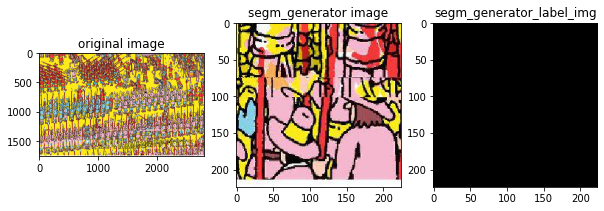

In [ ]:
sg = segm_generator(imgs, labels, 4, train=False)
b_img, b_label = next(sg)
plt.figure(figsize=(10,8))
plt.subplot(1,3,1)
plt.title('original image')
plt.imshow(imgs[0])
plt.subplot(1,3,2)
plt.title('segm_generator image')
plt.imshow(b_img[0])
plt.subplot(1,3,3)
plt.title('segm_generator_label_img')
plt.imshow(b_label[0][:,1].reshape(224,224), cmap='gray')

제너레이터 실행

In [ ]:
def seg_gen_mix(x1, y1, x2, y2, tot_bs=4, prop=0.34, out_sz=(224,224), train=True):

    n1 = int(tot_bs*prop)
    n2 = tot_bs - n1
    sg1 = segm_generator(x1, y1, n1, out_sz = out_sz ,train=train)
    sg2 = segm_generator(x2, y2, n2, out_sz = out_sz ,train=train, waldo=False)
    while True:
        out1 = sg1.__next__()
        out2 = sg2.__next__()
        if out2 is None:
            yield out1
        else:
            yield np.concatenate((out1[0], out2[0])), np.concatenate((out1[1], out2[1]))

증식한 이미지 테스트/ 랜덤으로 크롭한 이미지 데이터 테스트

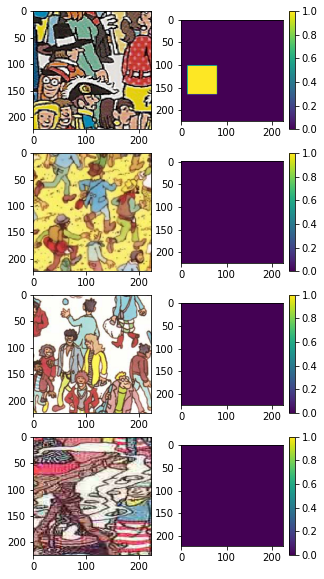

In [ ]:
PANNEL_SIZE= 224
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels, tot_bs=4, prop=0.34, out_sz=(PANNEL_SIZE, PANNEL_SIZE))

X, y = next(gen_mix)

plt.figure(figsize=(5, 10))
for i, img in enumerate(X):
    plt.subplot(X.shape[0], 2, 2*i+1)
    plt.imshow(X[i])
    plt.subplot(X.shape[0], 2, 2*i+2)
    plt.colorbar()
    plt.imshow(y[i][:,1].reshape((PANNEL_SIZE, PANNEL_SIZE)))

데이터 EDA

-결과값으로 0,1이 나올수 있다는 것을 알려준다.
1이 ㅣ나오면 월리가 포함된 데이터라는 뜻으로 차이가 극과 극이다.

88666846 37154


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


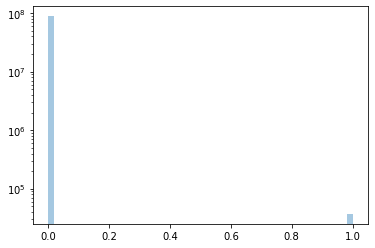

In [ ]:
freq0 = np.sum(labels==0)
freq1 = np.sum(labels==1)

print(freq0, freq1)

sns.distplot(labels.flatten(), kde=False, hist_kws={'log':True})

모델생성

-작아졌다가 커지는 cnn인코더 디코더 모델

In [ ]:
inputs = layers.Input(shape=(PANNEL_SIZE, PANNEL_SIZE, 3))

net = layers.Conv2D(64, kernel_size=3, padding='same')(inputs)
net = layers.LeakyReLU()(net)
net = layers.MaxPool2D(pool_size=2)(net)

shortcut_1 = net

net = layers.Conv2D(128, kernel_size=3, padding='same')(net)
net = layers.LeakyReLU()(net)
net = layers.MaxPool2D(pool_size=2)(net)

shortcut_2 = net

net = layers.Conv2D(256, kernel_size=3, padding='same')(net)
net = layers.LeakyReLU()(net)
net = layers.MaxPool2D(pool_size=2)(net)

shortcut_3 = net

net = layers.Conv2D(256, kernel_size=1, padding='same')(net)
net = layers.LeakyReLU()(net)
net = layers.MaxPool2D(pool_size=2)(net)

net = layers.UpSampling2D(size=2)(net)
net = layers.Conv2D(256, kernel_size=3, padding='same')(net)
net = layers.Activation('relu')(net)

net = layers.Add()([net, shortcut_3])

net = layers.UpSampling2D(size=2)(net)
net = layers.Conv2D(128, kernel_size=3, padding='same')(net)
net = layers.Activation('relu')(net)

net = layers.Add()([net, shortcut_2])

net = layers.UpSampling2D(size=2)(net)
net = layers.Conv2D(64, kernel_size=3, padding='same')(net)
net = layers.Activation('relu')(net)

net = layers.Add()([net, shortcut_1])

net = layers.UpSampling2D(size=2)(net)
net = layers.Conv2D(2, kernel_size=1, padding='same')(net)

net = layers.Reshape((-1, 2))(net)
net = layers.Activation('softmax')(net)

model = Model(inputs=inputs, outputs=net)

model.compile(
    loss='categorical_crossentropy', 
    optimizer=optimizers.Adam(), 
    metrics=['acc'], 
)

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 224, 224, 64  0           ['conv2d[0][0]']                 
                                )                                                             

학습
- seg_gen_mix로 증식하고, class_weight로 아까 생성한 sample_weights를 넣어준 뒤 학습한다.

In [ ]:
gen_mix = seg_gen_mix(waldo_sub_imgs, waldo_sub_labels, imgs, labels, tot_bs=6, prop=0.34, out_sz=(PANNEL_SIZE, PANNEL_SIZE))

def on_epoch_end(epoch, logs):
    print('\r', 'Epoch:%5d - loss: %.4f - acc: %.4f' % (epoch, logs['loss'],logs['acc']), end='')

print_callback = LambdaCallback(on_epoch_end=on_epoch_end)

history = model.fit(
    gen_mix, steps_per_epoch=6, epochs=1000, 
    verbose=0,
    callbacks=[
        print_callback,
        ReduceLROnPlateau(monitor='loss', factor=0.2, patience=100, verbose=1, mode='auto', min_lr=1e-05)
    ]
)

 Epoch:  680 - loss: 0.0037 - acc: 0.9985
Epoch 681: ReduceLROnPlateau reducing learning rate to 0.00020000000949949026.
 Epoch:  780 - loss: 0.0017 - acc: 0.9993
Epoch 781: ReduceLROnPlateau reducing learning rate to 4.0000001899898055e-05.
 Epoch:  893 - loss: 0.0018 - acc: 0.9992
Epoch 894: ReduceLROnPlateau reducing learning rate to 1e-05.
 Epoch:  999 - loss: 0.0017 - acc: 0.9993

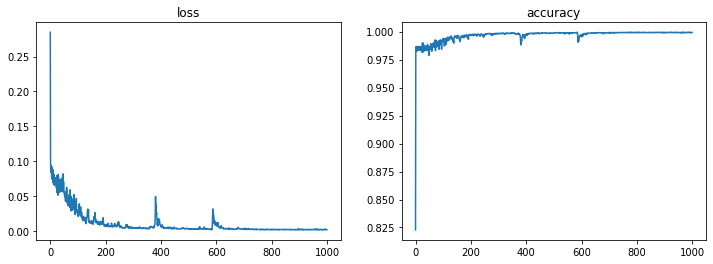

In [ ]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.title('loss')
plt.plot(history.history['loss'])
plt.subplot(1, 2, 2)
plt.title('accuracy')
plt.plot(history.history['acc'])

In [ ]:
from google.colab import files
files.upload()

Saving 월리1.jpg to 월리1.jpg
Saving 월리2.jpg to 월리2.jpg
Saving 월리3.jpg to 월리3.jpg
Saving 월리4.jpg to 월리4.jpg


{'월리1.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xee\x00\x0eAdobe\x00d\xc0\x00\x00\x00\x01\xff\xdb\x00C\x00\x08\x06\x06\x06\x06\x06\x08\x06\x06\x08\x0c\x08\x07\x08\x0c\x0e\n\x08\x08\n\x0e\x10\r\r\x0e\r\r\x10\x11\x0c\x0e\r\r\x0e\x0c\x11\x0f\x12\x13\x14\x13\x12\x0f\x18\x18\x1a\x1a\x18\x18#"""#\'\'\'\'\'\'\'\'\'\'\xff\xdb\x00C\x01\t\x08\x08\t\n\t\x0b\t\t\x0b\x0e\x0b\r\x0b\x0e\x11\x0e\x0e\x0e\x0e\x11\x13\r\r\x0e\r\r\x13\x18\x11\x0f\x0f\x0f\x0f\x11\x18\x16\x17\x14\x14\x14\x17\x16\x1a\x1a\x18\x18\x1a\x1a!! !!\'\'\'\'\'\'\'\'\'\'\xff\xc0\x00\x11\x08\x03\x00\x04\x00\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1c\x00\x00\x03\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x05\x06\x07\x04\x03\x02\x01\x00\x08\xff\xc4\x00N\x10\x00\x02\x02\x01\x03\x03\x03\x02\x04\x04\x04\x05\x03\x00\x00\x17\x01\x02\x03\x04\x05\x00\x11\x12\x06\x13!"1A\x14Q#2aq\x07\x15B\x813Rb\x91\x16$r\x82\xa1C\x92\xb1%S\xc14\xa2Dc\xb2\xd1\x17&s\xc2T\x83\x93\xe1\xf05E\xa3\xd2\xf1\x

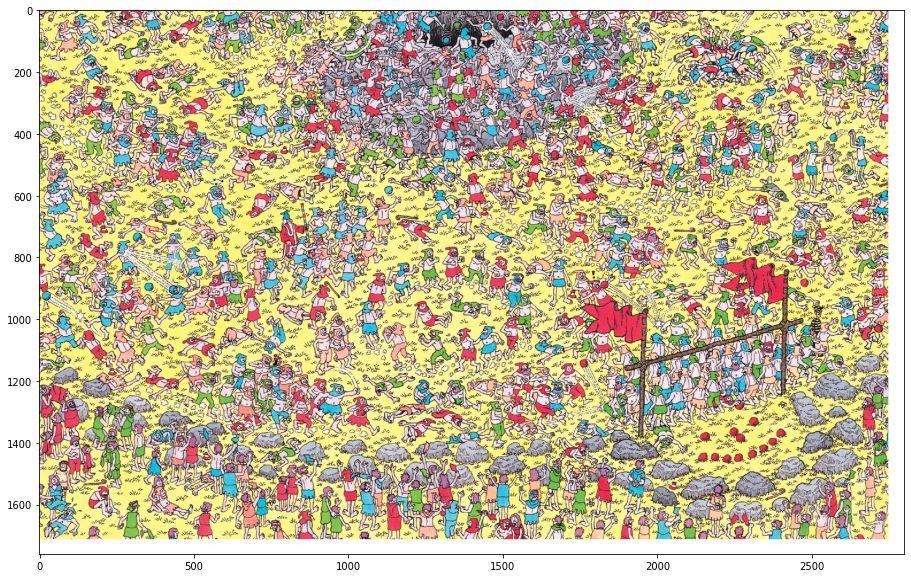

In [ ]:
img_filename = '월리2.jpg'
test_img = np.array(Image.open(os.path.join(img_filename)).resize((2800, 1760), Image.NEAREST)).astype(np.float32) / 255.

plt.figure(figsize=(20, 10))
plt.imshow(test_img)

불러온 테스트 이미지의 전처리를위해 함수로 정의

In [ ]:
def img_resize(img):
  h, w, _ = img.shape
  nvpanels = int(h/PANNEL_SIZE)
  nhpanels = int(w/PANNEL_SIZE)
  new_h, new_w = h, w
  if nvpanels*PANNEL_SIZE != h:
    new_h = (nvpanels+1)*PANNEL_SIZE
  if nhpanels*PANNEL_SIZE != w:
    new_w = (nhpanels+1)*PANNEL_SIZE
  if new_h == h and new_w == w:
    return img
  else:
    return resize(img, output_shape=(new_h, new_w), preserve_range=True)

def split_panels(img):
  h, w, _ = img.shape
  num_vert_panels = int(h/PANNEL_SIZE)
  num_hor_panels = int(w/PANNEL_SIZE)
  panels = []
  for i in range(num_vert_panels):
    for j in range(num_hor_panels):
      panels.append(img[i*PANNEL_SIZE:(i+1)*PANNEL_SIZE,j*PANNEL_SIZE:(j+1)*PANNEL_SIZE])
  return np.stack(panels)

def combine_panels(img, panels):
  h, w, _ = img.shape
  num_vert_panels = int(h/PANNEL_SIZE)
  num_hor_panels = int(w/PANNEL_SIZE)
  total = []
  p = 0
  for i in range(num_vert_panels):
    row = []
    for j in range(num_hor_panels):
      row.append(panels[p])
      p += 1
    total.append(np.concatenate(row, axis=1))
  return np.concatenate(total, axis=0)

In [ ]:
test_img = img_resize(test_img)

panels = split_panels(test_img)

out = combine_panels(test_img, panels)

print(panels.shape, test_img.shape, out.shape)

(104, 224, 224, 3) (1792, 2912, 3) (1792, 2912, 3)


In [ ]:
plt.imshow(panels[20])

SyntaxError: ignored

예측

In [ ]:
pred_panels = model.predict(panels).reshape((-1, PANNEL_SIZE, PANNEL_SIZE, 2))[:, :, :, 1]

pred_out = combine_panels(test_img, pred_panels)

# compute coordinates and confidence
argmax_x = np.argmax(np.max(pred_out, axis=0), axis=0)
argmax_y = np.argmax(np.max(pred_out, axis=1), axis=0)
confidence = np.amax(pred_out) * 100

print('(%s, %s) %.2f%%' % (argmax_x, argmax_y, confidence))

plt.figure(figsize=(20, 10))
plt.imshow(pred_out)
plt.colorbar()

마스크값 확인

In [ ]:
def bbox_from_mask(img):
  rows = np.any(img, axis=1)
  cols = np.any(img, axis=0)
  y1, y2 = np.where(rows)[0][[0, -1]]
  x1, x2 = np.where(cols)[0][[0, -1]]
  return x1, y1, x2, y2

x1, y1, x2, y2 = bbox_from_mask((pred_out > 0.9).astype(np.uint8))
print(x1, y1, x2, y2)

# make overlay
overlay = np.repeat(np.expand_dims(np.zeros_like(pred_out, dtype=np.uint8), axis=-1), 3, axis=-1)
alpha = np.expand_dims(np.full_like(pred_out, 255, dtype=np.uint8), axis=-1)

overlay = np.concatenate([overlay, alpha], axis=-1)

overlay[y1:y2, x1:x2, 3] = 0

plt.figure(figsize=(20, 10))
plt.imshow(overlay)

테스트 이미지에 박스를 씌워주기 위해 결과 이미지를 오버레이

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))

ax.imshow(test_img)
ax.imshow(overlay, alpha=0.5)

rect = patches.Rectangle((x1, y1), width=x2-x1, height=y2-y1, linewidth=1.5, edgecolor='r', facecolor='none')
ax.add_patch(rect)

ax.set_axis_off()